In [1]:
import os
from dotenv import load_dotenv
import pandas as pd

from src.datasetgenerator import StratzQuery, DatasetGenerator

In [2]:
load_dotenv()
#querier = StratzQuery(os.getenv('STRATZ_TOKEN'))
#querier.get_match(7590822094)

csv_path = os.getenv('CSV_PATH')

if not os.getenv('STRATZ_TOKEN'):
    raise FileNotFoundError("Not found STRATZ_TOKEN on .env")

generator = DatasetGenerator(os.getenv('STRATZ_TOKEN'), csv_path)

In [3]:
leagues = generator.get_professional_league([16842, 16840, 16841, 16839, 16843, 16844])
len(leagues)

6

In [4]:
leagues

{16842: {'id': 16842,
  'name': None,
  'banner': None,
  'tier': 'PROFESSIONAL',
  'region': 'EUROPE',
  'startDateTime': 1717718400,
  'endDateTime': 1719187200,
  'tournamentUrl': 'https://www.dota2.com',
  'lastMatchDate': 1719163998,
  'displayName': 'Road To The International 2024  - Regional Qualifiers Western Europe',
  'description': 'The highly anticipated DOTA 2 tournament, The International 2024, is on the horizon. However, before the main event, teams from the 6 regions without direct invites will have their chance to compete for a spot in the tournament.\nThe Regional Qualifiers for The International 2024 are scheduled to take place from June 9 to June 23.\n',
  'matches': [{'id': 7811671022,
    'didRadiantWin': True,
    'durationSeconds': 2442,
    'startDateTime': 1719161556,
    'firstBloodTime': 93,
    'averageRank': None,
    'players': [{'playerSlot': 0,
      'isRadiant': True,
      'steamAccountId': 331855530,
      'steamAccount': {'rankShift': 2,
       'isA

In [5]:
matches = []
for id, league in leagues.items():
    for match in league['matches']:
        matches.append(match)
len(matches)

232

In [6]:
matches[0]['playbackData']['wardEvents'][0]

{'indexId': 450,
 'time': -63,
 'positionX': 126,
 'positionY': 126,
 'fromPlayer': 4,
 'wardType': 'OBSERVER',
 'action': 'SPAWN',
 'playerDestroyed': None}

In [7]:
def get_deaths_through_ward(match:dict):

    # if match[']
    deaths_through_ward = {
        'time': [],
        'isPlayerRadiant': [],
        'positionX': [],
        'positionY': [],
    }
    for player in match["players"]:
        isPlayerRadiant = player['isRadiant']
        deaths_events = player['playbackData']['deathEvents']
        for d_e in deaths_events:
            if not d_e['isWardWalkThrough']:
                continue
            deaths_through_ward['time'].append(d_e['time'])
            deaths_through_ward['isPlayerRadiant'].append(isPlayerRadiant)
            deaths_through_ward['positionX'].append(d_e['positionX'])
            deaths_through_ward['positionY'].append(d_e['positionY'])
    
    df_deaths = pd.DataFrame.from_dict(deaths_through_ward)
    df_deaths['match'] = match['id']
    return df_deaths

def get_deaths_through_ward_league(league_ids):
    
    league = generator.get_professional_league(league_ids)
    matches = []
    for id, league in leagues.items():
        for match in league['matches']:
            matches.append(match)

    df_deaths = pd.concat([get_deaths_through_ward(match) for match in matches])
    return df_deaths

df_deaths = get_deaths_through_ward_league([16842])
df_deaths

,time,isPlayerRadiant,positionX,positionY,match
0,1494,True,182,60,7811671022
1,1418,True,158,70,7811671022
2,1512,True,174,64,7811671022
3,829,True,152,64,7811671022
4,1487,True,194,70,7811671022
...,...,...,...,...,...
16,692,True,112,108,7786842368
17,939,True,102,76,7786842368
18,861,False,76,180,7786842368
19,41,False,134,136,7786842368


In [8]:


wards = get_match_wards(matches[0])
wards.keys(), len(wards.keys())

(dict_keys([450, 454, 459, 517, 548, 854, 1877, 1884, 2217, 2224, 2491, 2257, 881, 2227, 2383, 2400, 1656, 2215, 1950, 1683, 1126, 2487, 2146, 2457, 2405, 2047, 2425, 2451, 2088, 1040, 2551, 814, 2226, 2177, 2128, 1918, 2480, 2209, 856, 1848, 920, 1598, 747, 2508, 1720, 2529, 857, 1862, 1554, 2090, 2422, 1672, 541, 921, 1054, 2361, 2397, 1743, 2554, 866, 228, 261, 230, 2132, 2447, 2170, 746, 2152, 848, 2049, 1773, 2038, 2338, 1925, 1858, 1599, 1566, 1810, 2396, 2331, 2079, 2534, 1959, 231, 1926, 2134, 2308, 1768, 2273, 2406, 879, 1631, 452, 461, 775, 1624, 1668, 1713, 1736, 1876, 1775]),
 101)

In [10]:
# df_wards = df_wards[df_wards['wardType'] == 'OBSERVER'].drop(["wardType", "playerDestroyed"], axis=1)
df_wards = df_wards.drop(["playerDestroyed"], axis=1)

In [11]:
df_wards.isna().any()

id                       False
match                    False
spawned_time             False
despawned_time           False
positionX                False
positionY                False
wardType                 False
isRadiant                False
didRadiantWin            False
spawned_time_minute      False
despawned_time_minute    False
radiantTeam              False
direTeam                 False
league                   False
region                   False
dtype: bool

In [12]:
df_wards[['positionX', 'positionY']].describe()

,positionX,positionY
count,128400.000000,128400.00000
mean,125.419346,124.78757
std,29.988349,31.78688
min,58.000000,58.00000
25%,100.000000,98.00000
50%,124.000000,124.00000
75%,150.000000,152.00000
max,196.000000,196.00000


In [13]:
import matplotlib.image as mpimg
import matplotlib.pyplot as plt
from PIL import Image
import numpy as np

# bg_img = np.array(Image.open('assets\Game_map_7.33.webp').resize((500,500)))
# # bg_img = mpimg.imread('assets\Game_map_7.33.webp')
# print(type(bg_img), bg_img.shape)
# for name, group in df_wards.groupby('match'):

#     print(f"\n{group['match'].unique()} - {group['radiantTeam'].unique()} x {group['direTeam'].unique()}")
#     fig, ax = plt.subplots(figsize=(5, 5), dpi=100)
#     ax.imshow(bg_img, extent=[55, 200, 55, 200])  # Adjust extent to match your data range
#     ax.scatter(group['positionX'], group['positionY'], label=f'Match {name}', color=group['wardType'].map(lambda x: "yellow" if x == "OBSERVER" else "blue"))

#     # Show plot
#     plt.show()


In [14]:
df_wards.count().max(), df_deaths.count().max()

(np.int64(128400), np.int64(6241))

In [15]:
df_wards[['spawned_time', 'despawned_time']]

,spawned_time,despawned_time
0,-63,296.0
1,-62,297.0
2,-53,306.0
3,-17,342.0
4,-9,15.0
...,...,...
43,1190,1310.0
44,1192,1310.0
45,1196,1310.0
46,1201,1310.0


In [16]:
df_wards = df_wards.reset_index()
df_wards

,index,id,match,spawned_time,despawned_time,positionX,positionY,wardType,isRadiant,didRadiantWin,spawned_time_minute,despawned_time_minute,radiantTeam,direTeam,league,region
0,0,7811671022_450,7811671022,-63,296.0,126,126,OBSERVER,True,True,-2,4,Tundra Esports,PSG.Quest,16842,EUROPE
1,1,7811671022_454,7811671022,-62,297.0,154,100,OBSERVER,True,True,-2,4,Tundra Esports,PSG.Quest,16842,EUROPE
2,2,7811671022_459,7811671022,-53,306.0,120,122,OBSERVER,False,True,-1,5,Tundra Esports,PSG.Quest,16842,EUROPE
3,3,7811671022_517,7811671022,-17,342.0,138,82,OBSERVER,False,True,-1,5,Tundra Esports,PSG.Quest,16842,EUROPE
4,4,7811671022_548,7811671022,-9,15.0,128,74,SENTRY,False,True,-1,0,Tundra Esports,PSG.Quest,16842,EUROPE
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
128395,43,7786842368_2439,7786842368,1190,1310.0,76,132,SENTRY,False,False,19,21,The Chapulines,Shopify Rebellion,16844,NA
128396,44,7786842368_2313,7786842368,1192,1310.0,134,88,SENTRY,True,False,19,21,The Chapulines,Shopify Rebellion,16844,NA
128397,45,7786842368_1040,7786842368,1196,1310.0,94,120,OBSERVER,False,False,19,21,The Chapulines,Shopify Rebellion,16844,NA
128398,46,7786842368_2405,7786842368,1201,1310.0,136,100,OBSERVER,True,False,20,21,The Chapulines,Shopify Rebellion,16844,NA


In [19]:
train_data = df_expanded.copy()
train_data["win"] = train_data['isRadiant'] == train_data['didRadiantWin']
train_data.drop(['id', 'match', 'didRadiantWin', 'radiantTeam', 'direTeam', 'league', 'region'], axis=1, inplace=True)
train_data['isRadiant'] = train_data['isRadiant'].astype(int)
train_data['win'] = train_data['win'].astype(int)
train_data

,time,positionX,positionY,wardType,isRadiant,win
0,-2,126,126,OBSERVER,1,1
1,-1,126,126,OBSERVER,1,1
2,0,126,126,OBSERVER,1,1
3,1,126,126,OBSERVER,1,1
4,2,126,126,OBSERVER,1,1
...,...,...,...,...,...,...
607831,20,134,88,SENTRY,1,0
607832,19,94,120,OBSERVER,0,1
607833,20,94,120,OBSERVER,0,1
607834,20,136,100,OBSERVER,1,0


In [20]:
def create_time_rows(row):
    return [{'time': t, **row} for t in range(row['spawned_time_minute'], row['despawned_time_minute']) if row['id']]

In [21]:
def get_dataset():
    df_wards = get_leagues_df_wards([16842, 16840, 16841, 16839, 16843, 16844])
    
    df_wards = df_wards[df_wards['wardType'] == 'OBSERVER'].drop(["wardType", "playerDestroyed"], axis=1)
    
    # Apply the function and expand the DataFrame
    df_expanded = df_wards.apply(create_time_rows, axis=1).explode().reset_index(drop=True)

    # Convert the expanded rows from dictionaries back to a DataFrame
    df_expanded = pd.DataFrame([row for row in df_expanded.tolist() if isinstance(row, dict)])

    # Drop the original columns (optional)
    df_expanded.drop(['spawned_time', 'despawned_time','spawned_time_minute', 'despawned_time_minute'], axis=1, inplace=True)

    # Print the expanded DataFrame

    
    train_data = df_expanded.copy()
    train_data["win"] = train_data['isRadiant'] == train_data['didRadiantWin']
    train_data.drop(['id', 'match', 'didRadiantWin', 'radiantTeam', 'direTeam', 'league', 'region'], axis=1, inplace=True)
    train_data['isRadiant'] = train_data['isRadiant'].astype(int)
    train_data['win'] = train_data['win'].astype(int)
    return train_data

In [22]:
import numpy as np
from sklearn.model_selection import train_test_split

train_data = get_dataset()

X = np.array(train_data.drop(["win"], axis=1))
y = np.array(train_data['win'])

X_train, X_test, y_train, y_test = train_test_split(X, y, train_size=0.7)
X_train.shape, X_test.shape

((149158, 4), (63926, 4))

In [23]:
from sklearn.tree import DecisionTreeClassifier

classifier = DecisionTreeClassifier()
classifier.fit(X_train, y_train)


DecisionTreeClassifier()

In [24]:
classifier.predict_proba(X)

array([[0.38709677, 0.61290323],
       [0.36      , 0.64      ],
       [0.28571429, 0.71428571],
       ...,
       [0.45      , 0.55      ],
       [0.38888889, 0.61111111],
       [0.07142857, 0.92857143]])

In [25]:
sum(classifier.predict(X_test) == y_test) / y_test.shape

array([0.81528642])

In [26]:
"""new_df = []
for (match, time, isRadiant), grouped_match in df_expanded.groupby(['match', 'time', 'isRadiant']):
    new_df_grouped = grouped_match.iloc[0:1].copy()
    new_df_grouped['positionX_0'] = new_df_grouped['positionX']
    new_df_grouped['positionY_0'] = new_df_grouped['positionY']
    for i, (_, row) in enumerate(grouped_match.iloc[1:].iterrows()):
        new_df_grouped[f"positionX_{i+1}"] = row['positionX']
        new_df_grouped[f"positionY_{i+1}"] = row['positionY']
    new_df.append(new_df_grouped)

df_merged = pd.concat(new_df)
df_merged = df_merged.reset_index().drop(['index', 'positionX', 'positionY'], axis=1)
df_merged"""

'new_df = []\nfor (match, time, isRadiant), grouped_match in df_expanded.groupby([\'match\', \'time\', \'isRadiant\']):\n    new_df_grouped = grouped_match.iloc[0:1].copy()\n    new_df_grouped[\'positionX_0\'] = new_df_grouped[\'positionX\']\n    new_df_grouped[\'positionY_0\'] = new_df_grouped[\'positionY\']\n    for i, (_, row) in enumerate(grouped_match.iloc[1:].iterrows()):\n        new_df_grouped[f"positionX_{i+1}"] = row[\'positionX\']\n        new_df_grouped[f"positionY_{i+1}"] = row[\'positionY\']\n    new_df.append(new_df_grouped)\n\ndf_merged = pd.concat(new_df)\ndf_merged = df_merged.reset_index().drop([\'index\', \'positionX\', \'positionY\'], axis=1)\ndf_merged'

In [27]:
df_expanded.isna().any()

time             False
id               False
match            False
positionX        False
positionY        False
wardType         False
isRadiant        False
didRadiantWin    False
radiantTeam      False
direTeam         False
league           False
region           False
dtype: bool

In [28]:
df_expanded[['positionX', 'positionY']].describe()

,positionX,positionY
count,607836.000000,607836.000000
mean,125.456676,124.990840
std,29.293917,31.702202
min,58.000000,58.000000
25%,102.000000,98.000000
50%,124.000000,124.000000
75%,148.000000,152.000000
max,196.000000,196.000000


,time,id,match,positionX,positionY,wardType,isRadiant,didRadiantWin,radiantTeam,direTeam,league,region
33447,-1,7804088213_2240,7804088213,196,116,SENTRY,True,False,Salvation Gaming,Talon,16842,EUROPE
14927,36,7805572483_2163,7805572483,58,116,OBSERVER,False,False,Twisted Minds,NAVI Junior,16842,EUROPE
6060,23,7808201077_2629,7808201077,126,196,OBSERVER,True,True,PSG.Quest,Nigma Galaxy,16842,EUROPE
2029,40,7811152782_2405,7811152782,114,58,OBSERVER,False,False,NAVI Junior,PSG.Quest,16842,EUROPE


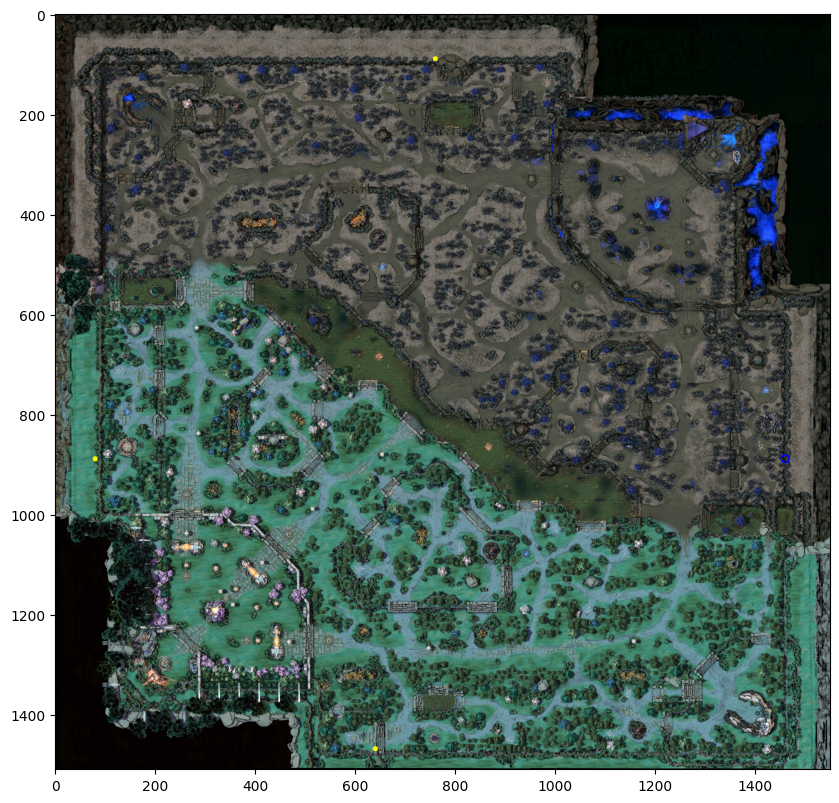

In [29]:
import cv2

MAP_SIZE = np.array((155, 151))
map_bg = cv2.imread("assets"+os.sep+"Game_map_7.33.webp")
map_bg = cv2.resize(map_bg, MAP_SIZE * 10)

def plot_ward(wards):
    plotted_map = map_bg.copy()
    plotted_map = cv2.flip(plotted_map, 0)
    positions_x = list((wards['positionX'] -50) * 10)
    positions_y = list((wards['positionY'] -54) * 10)
    wards_types = list(wards['wardType'])
    radius = 5
    thickness = -1
    for px, py, ward_type in zip(positions_x, positions_y, wards_types):
        center = px, py
        
        radius = 5 if ward_type == "OBSERVER" else 8
        thickness = -1 if ward_type == "OBSERVER" else 2
        color = color = (255, 255, 0) if ward_type == "OBSERVER" else (0, 0, 255)
        cv2.circle(plotted_map, center, radius, color, thickness)
    plotted_map = cv2.flip(plotted_map, 0)
    return plotted_map


sample = pd.concat([
    df_expanded.iloc[df_expanded['positionX'].idxmax()].to_frame().T,
    df_expanded.iloc[df_expanded['positionX'].idxmin()].to_frame().T,
    df_expanded.iloc[df_expanded['positionY'].idxmax()].to_frame().T,
    df_expanded.iloc[df_expanded['positionY'].idxmin()].to_frame().T,
])

plotted_map = plot_ward(sample)
plt.figure(figsize=(10,10))
plt.imshow(plotted_map)
sample

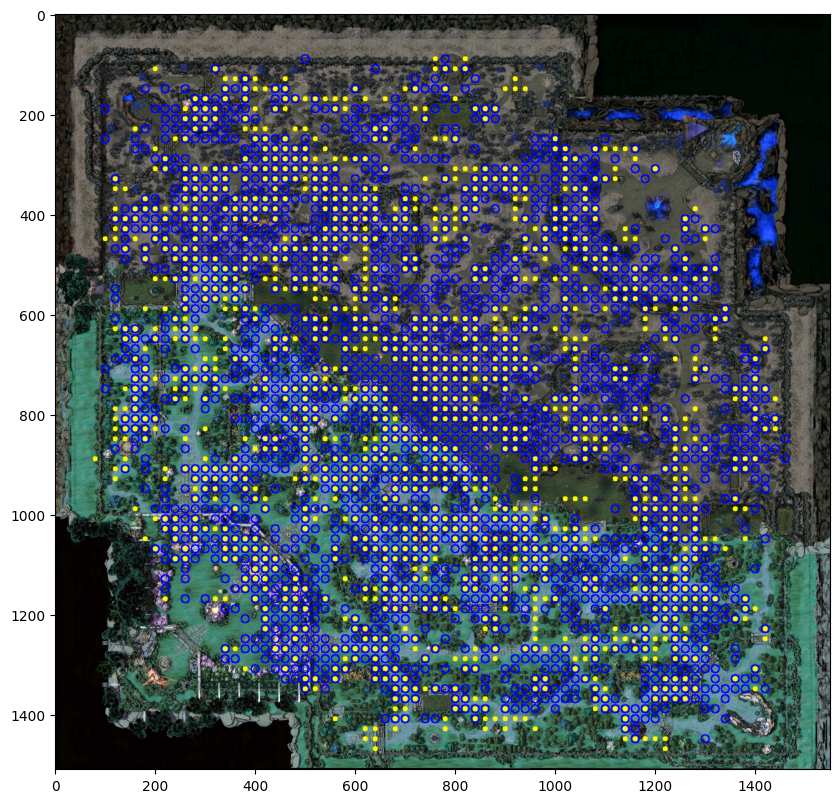

In [30]:
plotted_map = plot_ward(df_expanded)
plt.figure(figsize=(10,10))
plt.imshow(plotted_map)

## tensors

In [31]:
df_expanded

,time,id,match,positionX,positionY,wardType,isRadiant,didRadiantWin,radiantTeam,direTeam,league,region
0,-2,7811671022_450,7811671022,126,126,OBSERVER,True,True,Tundra Esports,PSG.Quest,16842,EUROPE
1,-1,7811671022_450,7811671022,126,126,OBSERVER,True,True,Tundra Esports,PSG.Quest,16842,EUROPE
2,0,7811671022_450,7811671022,126,126,OBSERVER,True,True,Tundra Esports,PSG.Quest,16842,EUROPE
3,1,7811671022_450,7811671022,126,126,OBSERVER,True,True,Tundra Esports,PSG.Quest,16842,EUROPE
4,2,7811671022_450,7811671022,126,126,OBSERVER,True,True,Tundra Esports,PSG.Quest,16842,EUROPE
...,...,...,...,...,...,...,...,...,...,...,...,...
607831,20,7786842368_2313,7786842368,134,88,SENTRY,True,False,The Chapulines,Shopify Rebellion,16844,NA
607832,19,7786842368_1040,7786842368,94,120,OBSERVER,False,False,The Chapulines,Shopify Rebellion,16844,NA
607833,20,7786842368_1040,7786842368,94,120,OBSERVER,False,False,The Chapulines,Shopify Rebellion,16844,NA
607834,20,7786842368_2405,7786842368,136,100,OBSERVER,True,False,The Chapulines,Shopify Rebellion,16844,NA


In [32]:
POSITION_X_OFFSET = -50
POSITION_Y_OFFSET = -54

train_data = df_expanded[df_expanded["wardType"] == "OBSERVER"]
train_data = train_data.drop(["id", "match", "wardType", "radiantTeam", "direTeam", "league", "region"], axis=1)
train_data['positionX'] = train_data['positionX'] + POSITION_X_OFFSET
train_data['positionY'] = train_data['positionY'] + POSITION_Y_OFFSET
train_data

,time,positionX,positionY,isRadiant,didRadiantWin
0,-2,76,72,True,True
1,-1,76,72,True,True
2,0,76,72,True,True
3,1,76,72,True,True
4,2,76,72,True,True
...,...,...,...,...,...
607816,19,84,24,False,False
607817,20,84,24,False,False
607832,19,44,66,False,False
607833,20,44,66,False,False


In [33]:
train_data[['positionX','positionY']].describe()

,positionX,positionY
count,213084.000000,213084.000000
mean,75.324379,71.194064
std,27.944854,31.643428
min,8.000000,4.000000
25%,54.000000,46.000000
50%,74.000000,70.000000
75%,94.000000,96.000000
max,144.000000,142.000000


In [34]:
def plot_y_images(df):
    new_df = {
        "time": [],
        "isRadiant": [],
        "map": [],
    }
    for (time, isRadiant), wards_by_time_team in df.groupby(["time", "isRadiant"]):
        map = np.zeros((int(MAP_SIZE[0] / 2), int(MAP_SIZE[1] / 2)), dtype=np.uint8)

        position_x = wards_by_time_team["positionX"] // 2
        position_y = wards_by_time_team["positionY"] // 2
        
        for px, py in zip(position_x, position_y):
            map[px, py] +=1
        map = map * 255.0 / map.max()
        new_df["time"].append(time)
        new_df["isRadiant"].append(isRadiant)
        new_df["map"].append(map)

    return pd.DataFrame(new_df)
        
deconv_train_data = plot_y_images(train_data[train_data['time'] < 60])
deconv_train_data

,time,isRadiant,map
0,-2,False,"[[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0,..."
1,-2,True,"[[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0,..."
2,-1,False,"[[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0,..."
3,-1,True,"[[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0,..."
4,0,False,"[[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0,..."
...,...,...,...
119,57,True,"[[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0,..."
120,58,False,"[[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0,..."
121,58,True,"[[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0,..."
122,59,False,"[[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0,..."


In [35]:
np.unique(deconv_train_data['map'].iloc[0])

array([  0.,  51., 102., 153., 204., 255.])

In [36]:
# plot_ward

def show_map(row):
    team_name = "Radiant" if row['isRadiant'] else "Dire"
    time = row['time']
    plt.imshow(row['transformed_map'])
    plt.title(f"{team_name} team at {time}min mark")
    plt.axis('off')
    plt.show()

def show_map_merged(row):
    print(row)
    time = row['time']
    plt.imshow(row['map'])
    plt.title(f"At {time} min mark")
    plt.axis('off')
    plt.figure(figsize=(10,10))
    plt.show()

def transform_map(map):
    map = cv2.flip(map.copy(), 0)
    map = cv2.cvtColor(np.array(map, dtype=np.uint8), cv2.COLOR_GRAY2BGR)
    map[:,:,[]] = 0
    map = cv2.resize(map, MAP_SIZE * 10, interpolation=cv2.INTER_NEAREST)
    alpha_mask = map / 255.
    merged_map = np.array((map * alpha_mask) + map_bg * (1 - alpha_mask), dtype=np.uint8)
    return merged_map

def merge_teams_map(df):
    new_df = {
        "time": [],
        "map": [],
    }
    for time, grouped_by_time in df.groupby("time"):
        map = np.zeros((*grouped_by_time['map'].iloc[0].shape, 3))
        curr_maps = grouped_by_time['map']
        isRadiants = grouped_by_time['isRadiant']
        for curr_map, isRadiant in zip(curr_maps, isRadiants):
            map[:,:, 1 if isRadiant else 0] = cv2.flip(curr_map.copy(), 0)
        map = cv2.resize(map, MAP_SIZE * 10, interpolation=cv2.INTER_NEAREST)
        alpha_mask = (map / 255.)
        #merged_map = np.array((map * alpha_mask) + map_bg * (1 - alpha_mask), dtype=np.uint8)
        merged_map = map_bg.copy()
        map_mask = alpha_mask > 0.5
        merged_map[map_mask] = 255* (map[map_mask]/ map[map_mask])
        new_df['time'].append(time)
        new_df['map'].append(merged_map)
    return pd.DataFrame(new_df)

deconv_train_data['transformed_map'] = deconv_train_data['map'].map(transform_map)
# deconv_train_data[deconv_train_data["time"] % 10 == 0].apply(show_map, axis=1)
df_merged_map = merge_teams_map(deconv_train_data[deconv_train_data["time"] % 10 == 0])
df_merged_map

,time,map
0,0,"[[[63, 67, 62], [63, 66, 64], [67, 69, 69], [6..."
1,10,"[[[63, 67, 62], [63, 66, 64], [67, 69, 69], [6..."
2,20,"[[[63, 67, 62], [63, 66, 64], [67, 69, 69], [6..."
3,30,"[[[63, 67, 62], [63, 66, 64], [67, 69, 69], [6..."
4,40,"[[[63, 67, 62], [63, 66, 64], [67, 69, 69], [6..."
5,50,"[[[63, 67, 62], [63, 66, 64], [67, 69, 69], [6..."


time                                                    0
map     [[[63, 67, 62], [63, 66, 64], [67, 69, 69], [6...
Name: 0, dtype: object


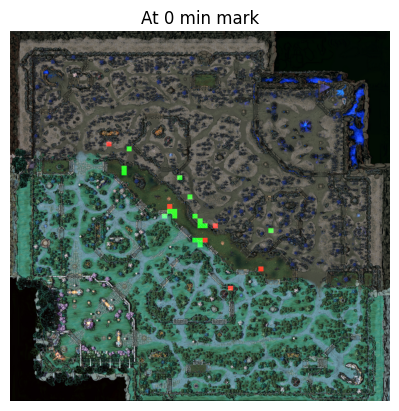

<Figure size 1000x1000 with 0 Axes>

time                                                   10
map     [[[63, 67, 62], [63, 66, 64], [67, 69, 69], [6...
Name: 1, dtype: object


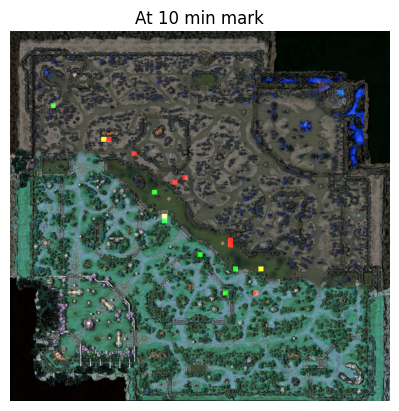

<Figure size 1000x1000 with 0 Axes>

time                                                   20
map     [[[63, 67, 62], [63, 66, 64], [67, 69, 69], [6...
Name: 2, dtype: object


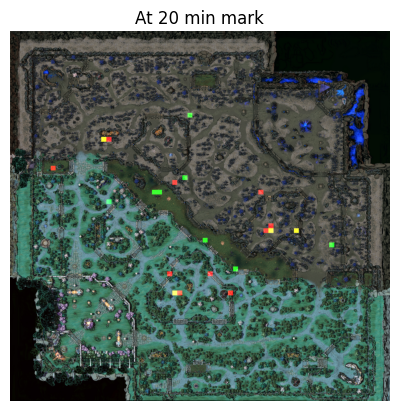

<Figure size 1000x1000 with 0 Axes>

time                                                   30
map     [[[63, 67, 62], [63, 66, 64], [67, 69, 69], [6...
Name: 3, dtype: object


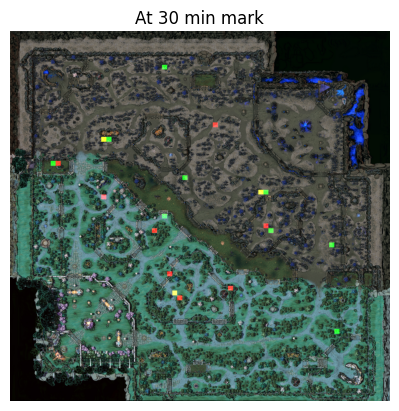

<Figure size 1000x1000 with 0 Axes>

time                                                   40
map     [[[63, 67, 62], [63, 66, 64], [67, 69, 69], [6...
Name: 4, dtype: object


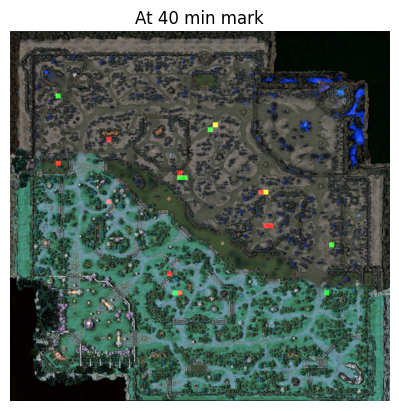

<Figure size 1000x1000 with 0 Axes>

time                                                   50
map     [[[63, 67, 62], [63, 66, 64], [67, 69, 69], [6...
Name: 5, dtype: object


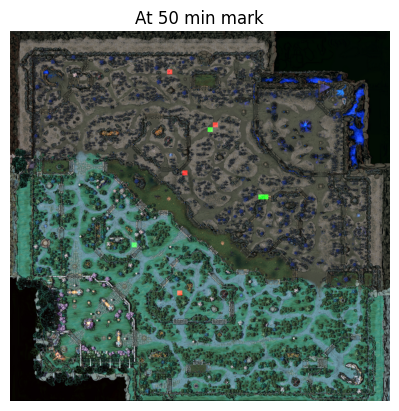

<Figure size 1000x1000 with 0 Axes>

0    None
1    None
2    None
3    None
4    None
5    None
dtype: object

In [37]:
df_merged_map.apply(show_map_merged, axis=1)

In [38]:
deconv_train_data

,time,isRadiant,map,transformed_map
0,-2,False,"[[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0,...","[[[63, 67, 62], [63, 66, 64], [67, 69, 69], [6..."
1,-2,True,"[[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0,...","[[[63, 67, 62], [63, 66, 64], [67, 69, 69], [6..."
2,-1,False,"[[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0,...","[[[63, 67, 62], [63, 66, 64], [67, 69, 69], [6..."
3,-1,True,"[[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0,...","[[[63, 67, 62], [63, 66, 64], [67, 69, 69], [6..."
4,0,False,"[[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0,...","[[[63, 67, 62], [63, 66, 64], [67, 69, 69], [6..."
...,...,...,...,...
119,57,True,"[[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0,...","[[[63, 67, 62], [63, 66, 64], [67, 69, 69], [6..."
120,58,False,"[[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0,...","[[[63, 67, 62], [63, 66, 64], [67, 69, 69], [6..."
121,58,True,"[[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0,...","[[[63, 67, 62], [63, 66, 64], [67, 69, 69], [6..."
122,59,False,"[[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0,...","[[[63, 67, 62], [63, 66, 64], [67, 69, 69], [6..."


In [39]:
deconv_train_data['transformed_map'].to_numpy()

array([array([[[ 63,  67,  62],
               [ 63,  66,  64],
               [ 67,  69,  69],
               ...,
               [  0,  11,   2],
               [  0,  11,   2],
               [  0,  11,   2]],

              [[ 61,  64,  54],
               [ 41,  44,  36],
               [ 12,  15,  13],
               ...,
               [  0,  11,   2],
               [  0,  11,   2],
               [  0,  11,   2]],

              [[ 56,  59,  49],
               [ 43,  45,  38],
               [ 30,  29,  23],
               ...,
               [  0,  11,   2],
               [  0,  11,   2],
               [  0,  11,   2]],

              ...,

              [[  4,   1,   1],
               [  3,   1,   1],
               [  2,   0,   0],
               ...,
               [118, 138, 139],
               [113, 133, 134],
               [127, 145, 146]],

              [[  1,   1,   1],
               [  1,   1,   1],
               [  0,   0,   0],
               ...,
        

In [40]:
X = np.array(deconv_train_data.drop(["map", "transformed_map"], axis=1), dtype=np.float32)
# Convert each element to uint8 and stack them into a single numpy array
y = [arr.astype(np.uint8) for arr in deconv_train_data['transformed_map'].to_numpy()]
y = np.stack(y, dtype=np.float32)

X.shape, y.shape

((124, 2), (124, 1510, 1550, 3))

In [41]:

def transform_map(map):
    map = cv2.flip(map.copy(), 0)
    map = cv2.cvtColor(np.array(map, dtype=np.uint8), cv2.COLOR_GRAY2BGR)
    map[:,:,[]] = 0
    map = cv2.resize(map, MAP_SIZE * 10, interpolation=cv2.INTER_NEAREST)
    alpha_mask = map / 255.
    merged_map = np.array((map * alpha_mask) + map_bg * (1 - alpha_mask), dtype=np.uint8)
    return merged_map
y = deconv_train_data['map'].map(transform_map)

In [52]:
y = np.stack(list(deconv_train_data['map'].map(lambda x: np.array(x, dtype=float))))
y.dtype, y.shape

(dtype('float64'), (124, 77, 75))

In [41]:
deconv_train_data.to_csv("test.csv")

In [42]:
deconv_train_data = pd.read_csv('test.csv')

In [45]:
deconv_train_data['map'].to_numpy(dtype=np.float32)

ValueError: could not convert string to float: '[[0. 0. 0. ... 0. 0. 0.]\n [0. 0. 0. ... 0. 0. 0.]\n [0. 0. 0. ... 0. 0. 0.]\n ...\n [0. 0. 0. ... 0. 0. 0.]\n [0. 0. 0. ... 0. 0. 0.]\n [0. 0. 0. ... 0. 0. 0.]]'

# Models

In [53]:
import torch
device = "cuda" if torch.cuda.is_available() else "cpu"
device

'cuda'

In [54]:
torch.tensor(y, dtype=torch.float32)


A module that was compiled using NumPy 1.x cannot be run in
NumPy 2.0.0 as it may crash. To support both 1.x and 2.x
versions of NumPy, modules must be compiled with NumPy 2.0.
Some module may need to rebuild instead e.g. with 'pybind11>=2.12'.

If you are a user of the module, the easiest solution will be to
downgrade to 'numpy<2' or try to upgrade the affected module.
We expect that some modules will need time to support NumPy 2.

Traceback (most recent call last):  File "<frozen runpy>", line 198, in _run_module_as_main
  File "<frozen runpy>", line 88, in _run_code
  File "c:\Users\glucas\Documents\a\repos\dota-ward-analasys\.venv\Lib\site-packages\ipykernel_launcher.py", line 18, in <module>
    app.launch_new_instance()
  File "c:\Users\glucas\Documents\a\repos\dota-ward-analasys\.venv\Lib\site-packages\traitlets\config\application.py", line 1075, in launch_instance
    app.start()
  File "c:\Users\glucas\Documents\a\repos\dota-ward-analasys\.venv\Lib\site-packages\ipykernel\ker

tensor([[[0., 0., 0.,  ..., 0., 0., 0.],
         [0., 0., 0.,  ..., 0., 0., 0.],
         [0., 0., 0.,  ..., 0., 0., 0.],
         ...,
         [0., 0., 0.,  ..., 0., 0., 0.],
         [0., 0., 0.,  ..., 0., 0., 0.],
         [0., 0., 0.,  ..., 0., 0., 0.]],

        [[0., 0., 0.,  ..., 0., 0., 0.],
         [0., 0., 0.,  ..., 0., 0., 0.],
         [0., 0., 0.,  ..., 0., 0., 0.],
         ...,
         [0., 0., 0.,  ..., 0., 0., 0.],
         [0., 0., 0.,  ..., 0., 0., 0.],
         [0., 0., 0.,  ..., 0., 0., 0.]],

        [[0., 0., 0.,  ..., 0., 0., 0.],
         [0., 0., 0.,  ..., 0., 0., 0.],
         [0., 0., 0.,  ..., 0., 0., 0.],
         ...,
         [0., 0., 0.,  ..., 0., 0., 0.],
         [0., 0., 0.,  ..., 0., 0., 0.],
         [0., 0., 0.,  ..., 0., 0., 0.]],

        ...,

        [[0., 0., 0.,  ..., 0., 0., 0.],
         [0., 0., 0.,  ..., 0., 0., 0.],
         [0., 0., 0.,  ..., 0., 0., 0.],
         ...,
         [0., 0., 0.,  ..., 0., 0., 0.],
         [0., 0., 0., 

In [44]:
X = torch.tensor(X, dtype=torch.float32)
X


A module that was compiled using NumPy 1.x cannot be run in
NumPy 2.0.0 as it may crash. To support both 1.x and 2.x
versions of NumPy, modules must be compiled with NumPy 2.0.
Some module may need to rebuild instead e.g. with 'pybind11>=2.12'.

If you are a user of the module, the easiest solution will be to
downgrade to 'numpy<2' or try to upgrade the affected module.
We expect that some modules will need time to support NumPy 2.

Traceback (most recent call last):  File "<frozen runpy>", line 198, in _run_module_as_main
  File "<frozen runpy>", line 88, in _run_code
  File "c:\Users\glucas\Documents\a\repos\dota-ward-analasys\.venv\Lib\site-packages\ipykernel_launcher.py", line 18, in <module>
    app.launch_new_instance()
  File "c:\Users\glucas\Documents\a\repos\dota-ward-analasys\.venv\Lib\site-packages\traitlets\config\application.py", line 1075, in launch_instance
    app.start()
  File "c:\Users\glucas\Documents\a\repos\dota-ward-analasys\.venv\Lib\site-packages\ipykernel\ker

tensor([[-2.,  0.],
        [-2.,  1.],
        [-1.,  0.],
        [-1.,  1.],
        [ 0.,  0.],
        [ 0.,  1.],
        [ 1.,  0.],
        [ 1.,  1.],
        [ 2.,  0.],
        [ 2.,  1.],
        [ 3.,  0.],
        [ 3.,  1.],
        [ 4.,  0.],
        [ 4.,  1.],
        [ 5.,  0.],
        [ 5.,  1.],
        [ 6.,  0.],
        [ 6.,  1.],
        [ 7.,  0.],
        [ 7.,  1.],
        [ 8.,  0.],
        [ 8.,  1.],
        [ 9.,  0.],
        [ 9.,  1.],
        [10.,  0.],
        [10.,  1.],
        [11.,  0.],
        [11.,  1.],
        [12.,  0.],
        [12.,  1.],
        [13.,  0.],
        [13.,  1.],
        [14.,  0.],
        [14.,  1.],
        [15.,  0.],
        [15.,  1.],
        [16.,  0.],
        [16.,  1.],
        [17.,  0.],
        [17.,  1.],
        [18.,  0.],
        [18.,  1.],
        [19.,  0.],
        [19.,  1.],
        [20.,  0.],
        [20.,  1.],
        [21.,  0.],
        [21.,  1.],
        [22.,  0.],
        [22.,  1.],


In [ ]:
y = torch.tensor(y, dtype=torch.float32)

In [42]:
arr = deconv_train_data['transformed_map'].to_numpy()
arr = torch.tensor(arr, dtype=torch.float32).to(device)
arr

In [ ]:
import torch
import torch.nn as nn

class WardPlacementNet(nn.Module):
    def __init__(self):
        
        super(WardPlacementNet, self).__init__()
        self.fc1 = nn.Linear(3, 128)  # Input: game_time, ward_type, is_radiant
        self.fc2 = nn.Linear(128, 256)
        self.fc3 = nn.Linear(256, 512)
        
        self.fc_to_conv = nn.Linear(512, 128 * 8 * 8)  # Adjust based on the desired output size
        
        self.deconv1 = nn.ConvTranspose2d(128, 64, kernel_size=4, stride=2, padding=1)
        self.deconv2 = nn.ConvTranspose2d(64, 32, kernel_size=4, stride=2, padding=1)
        self.deconv3 = nn.ConvTranspose2d(32, 1, kernel_size=4, stride=2, padding=1)
        
        self.relu = nn.ReLU()

    def forward(self, x):

        x = self.relu(self.fc1(x))
        x = self.relu(self.fc2(x))
        x = self.relu(self.fc3(x))
        
        x = self.relu(self.fc_to_conv(x))
        x = x.view(-1, 128, 8, 8)  # Adjust based on the desired output size
        
        x = self.relu(self.deconv1(x))
        x = self.relu(self.deconv2(x))
        x = torch.sigmoid(self.deconv3(x))  # Using sigmoid to output probability values
        
        return x
    
model = WardPlacementNet().to(device)